In [2]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import PROJECT.util as f
from matplotlib.pyplot import cm

In [3]:
# Pour des vecteurs u* et v*,
# les overlaps obtenus sont soit les deux positifs ou les deux négatifs, on a:
# overlap(u*)= -x et overlap(v*)= -y ou overlap(u*)= x et overlap(v*)= y.
# on prend donc le min(u-x, u+x):

# si u est positif et x est positif:
# min(u-x, u+x) -> u-x est bon

# si u est positif et x est négatif:
# min(u-(-x), u+(-x)) -> u+(-x) =u-x est bon

# si u est négatif et x est positif:
# min(-u-x, -u+x) -> -u+x =x-u est bon

# si u est négatif et x est négatif:
# min(-u-(-x), -u+(-x)) -> -u-(-x) =x-u est bon

def mse(x,y):
    a=torch.pow((x-y),2).mean(0)
    b=torch.pow((x+y),2).mean(0)
    return torch.min(a,b)

In [4]:
def main_gradient_2_sans_proj_normalisation(iteration, u_p, v_p, Y, u_, v_, N, M, lambda_, beta_u, beta_v, lambda_1, lambda_2, dt):

    res = []
    res_mse= []
    
    mod = iteration*0.1

    for i in range(iteration):

        # Computation
        sqrt_dt = torch.sqrt(dt)

        u_1 = (1/lambda_1) * f.gradient_u_2(N, M, u_p,v_p,Y,lambda_) * dt
        u_2 = torch.sqrt(2/(lambda_1*beta_u)) * torch.empty(N).normal_(mean=0,std=sqrt_dt)
        u_3 = ((N-1)/(N*lambda_1*beta_u))*u_p*dt
        u_n = u_p - u_1 + u_2 - u_3

        v_1 = 1/lambda_2 * f.gradient_v_2(N,M,u_p,v_p,Y,lambda_) * dt
        v_2 = torch.sqrt(2/(lambda_2*beta_v)) * torch.empty(M).normal_(mean=0,std=sqrt_dt)
        v_3 = ((M-1)/(M*lambda_2*beta_v))*v_p*dt
        v_n = v_p - v_1 + v_2 - v_3

        # Normalisation
        u_n = u_n / torch.linalg.norm(u_n)
        v_n = v_n / torch.linalg.norm(v_n)
        u_n = u_n * torch.sqrt(N)
        v_n = v_n * torch.sqrt(M)

        # Re-asign for the loop
        u_p = u_n
        v_p = v_n
    
        res_u = torch.abs(f.overlap(u_,u_n,N))
        res_v = torch.abs(f.overlap(v_,v_n,M))
        res.append((res_u,res_v))
        
        res_mse.append((mse(u_,u_n), mse(v_,v_n)))
        
        if i%mod==0:
            print(f"progress {100*i/iteration:.2f}%", end="\r")
        if i==iteration-1:
            print(f"overlap(u, v): ({res_u}; {res_v})")

    return np.array(res), np.array(res_mse)

In [5]:
def one_run(lambda_=2, N=500, M=500, beta_u=float("inf"), beta_v=float("inf"), lambda_1=1,
        lambda_2=1, dt=1/100, iteration=1000):
      #Size of the matrix Y
    N = torch.tensor(N)
    M = torch.tensor(M)

    # lambda
    lambda_ = torch.tensor(lambda_)

    #temperatures
    beta_u = torch.tensor(beta_u)
    beta_v = torch.tensor(beta_v)

    #learning rates
    lambda_1 = torch.tensor(lambda_1)
    lambda_2 = torch.tensor(lambda_2)

    # Pas de temps
    dt = torch.tensor(dt)

    u_ = f.generate_vector(N)
    v_ = f.generate_vector(M)

    Y = f.generate_Y(N, M, u_,v_, lambda_)
    #print(Y)

    # Conditions initiales
    u_p = f.generate_vector(N)
    v_p = f.generate_vector(M)

    # Perform the gradient descent
    (res, res_mse) = main_gradient_2_sans_proj_normalisation(iteration, u_p, v_p, Y, u_, v_, N, M, lambda_, beta_u, beta_v, lambda_1, lambda_2, dt)
    
    return res, res_mse


In [6]:
# MAIN METHOD:

def main(size_of_one_sample, list_value_1, list_value_2):
    
    all_overlap_iterations=[]
    all_final_overlaps=[]
    
    all_mse_iterations=[]
    all_final_mse=[]
    
    for value_to_test_1 in list_value_1:
        
        for value_to_test_2 in list_value_2:
        
            one_run_overlap_iterations=[]
            one_run_mse_iterations=[]

            # Calculation
            for _ in range(size_of_one_sample):
                (current_uv_overlap,current_uv_mse)=one_run(beta_u=value_to_test_1, beta_v=value_to_test_2)
                # Store the overlap at the end of each iterations:
                one_run_overlap_iterations.append(current_uv_overlap)
                # Store the mse at the end of each iterations:
                one_run_mse_iterations.append(current_uv_mse)

            # Store the overlap/mse at the final iteration:
            one_run_final_overlap = np.array([x[-1] for x in one_run_overlap_iterations])
            one_run_final_mse = np.array([x[-1] for x in one_run_mse_iterations])

            # Add the results of this specific run to the global array:
            # overlap at all iterations:
            all_overlap_iterations.append(one_run_overlap_iterations)
            # overlap at the final iteration:
            all_final_overlaps.append(one_run_final_overlap)
            # mse at all iterations:
            all_mse_iterations.append(one_run_mse_iterations)
            # mse at the final iteration:
            all_final_mse.append(one_run_final_mse)
            
    return np.array(all_overlap_iterations), np.array(all_final_overlaps), np.array(all_mse_iterations), np.array(all_final_mse)

In [7]:
# MAIN CELL: DO THE COMPUTATION

list_value_1 = np.arange(0.1, 3, 0.1)
#list_value_1 = np.array([2,1,0.5])

list_value_2 = np.arange(0.1, 3, 0.1)
#list_value_2 = np.array([2,1,0.5])

size_of_one_sample=2

(overlap_at_each_iterations, overlap_at_final_iteration,
 mse_at_each_iterations, mse_at_final_iteration) = main(size_of_one_sample, list_value_1, list_value_2)

overlap(u, v): (0.03344835713505745; 0.022157257422804832)
overlap(u, v): (0.007185198832303286; 0.04410451278090477)
overlap(u, v): (0.04683848097920418; 0.007614371366798878)
overlap(u, v): (0.07072044163942337; 0.021845471113920212)
overlap(u, v): (0.015201200731098652; 0.0247325636446476)
overlap(u, v): (0.030419152230024338; 0.05202609300613403)
overlap(u, v): (0.002920539816841483; 0.03655621409416199)
overlap(u, v): (0.004345704801380634; 0.1303536593914032)
overlap(u, v): (0.017641350626945496; 0.010386656038463116)
overlap(u, v): (0.03416964039206505; 0.0802733451128006)
overlap(u, v): (0.08806770294904709; 0.04859660565853119)
overlap(u, v): (0.10179544240236282; 0.04223429784178734)
overlap(u, v): (0.018200185149908066; 0.0008421139791607857)
overlap(u, v): (0.053814567625522614; 0.031031353399157524)
overlap(u, v): (0.08424468338489532; 0.12988048791885376)
overlap(u, v): (0.06202104315161705; 0.013899619691073895)
overlap(u, v): (0.05130043625831604; 0.017023811116814613)


overlap(u, v): (0.1703503429889679; 0.36850428581237793)
overlap(u, v): (0.04967446252703667; 0.011190276592969894)
overlap(u, v): (0.009654924273490906; 0.009748164564371109)
overlap(u, v): (0.03478381410241127; 0.01811845786869526)
overlap(u, v): (0.16099123656749725; 0.23778770864009857)
overlap(u, v): (0.30884453654289246; 0.47045886516571045)
overlap(u, v): (0.077458955347538; 0.20947147905826569)
overlap(u, v): (0.23591762781143188; 0.4003644287586212)
overlap(u, v): (0.19137844443321228; 0.2543286085128784)
overlap(u, v): (0.06400187313556671; 0.058228302747011185)
overlap(u, v): (0.2492912858724594; 0.39271384477615356)
overlap(u, v): (0.05194913595914841; 0.07532154768705368)
overlap(u, v): (0.3176971673965454; 0.4393397867679596)
overlap(u, v): (0.0009464130271226168; 0.0035519027151167393)
overlap(u, v): (0.19330237805843353; 0.3501622974872589)
overlap(u, v): (0.26581838726997375; 0.2665071189403534)
overlap(u, v): (0.12844033539295197; 0.22002816200256348)
overlap(u, v): (

overlap(u, v): (0.38288506865501404; 0.5485708117485046)
overlap(u, v): (0.2835606634616852; 0.3877534866333008)
overlap(u, v): (0.44939666986465454; 0.5505089163780212)
overlap(u, v): (0.374985933303833; 0.5677188634872437)
overlap(u, v): (0.13350658118724823; 0.09216153621673584)
overlap(u, v): (0.023573951795697212; 0.017529863864183426)
overlap(u, v): (0.3076319098472595; 0.42057859897613525)
overlap(u, v): (0.021709540858864784; 0.047186750918626785)
overlap(u, v): (0.006172363180667162; 0.032582465559244156)
overlap(u, v): (0.11354273557662964; 0.10235876590013504)
overlap(u, v): (0.05061721056699753; 0.05753813311457634)
overlap(u, v): (0.014530720189213753; 0.024303076788783073)
overlap(u, v): (0.06219257041811943; 0.1399751603603363)
overlap(u, v): (0.03790028393268585; 0.003032122505828738)
overlap(u, v): (0.11914079636335373; 0.003919227514415979)
overlap(u, v): (0.35834193229675293; 0.30993619561195374)
overlap(u, v): (0.01785004511475563; 0.08645884692668915)
overlap(u, v)

overlap(u, v): (0.47344547510147095; 0.5718490481376648)
overlap(u, v): (0.12457691878080368; 0.16676762700080872)
overlap(u, v): (0.5405678749084473; 0.600649893283844)
overlap(u, v): (0.4535790979862213; 0.49447858333587646)
overlap(u, v): (0.22117045521736145; 0.23305343091487885)
overlap(u, v): (0.6184848546981812; 0.6290913224220276)
overlap(u, v): (0.39225152134895325; 0.451047420501709)
overlap(u, v): (0.5922961235046387; 0.6537752747535706)
overlap(u, v): (0.5557478070259094; 0.6182994246482849)
overlap(u, v): (0.035218093544244766; 0.07177530229091644)
overlap(u, v): (0.07747328281402588; 0.03563305735588074)
overlap(u, v): (0.026998981833457947; 0.0044393655844032764)
overlap(u, v): (0.06168600544333458; 0.040545858442783356)
overlap(u, v): (0.17000699043273926; 0.10559431463479996)
overlap(u, v): (0.022599630057811737; 0.06632136553525925)
overlap(u, v): (0.37179163098335266; 0.2190111130475998)
overlap(u, v): (0.36968401074409485; 0.2734271287918091)
overlap(u, v): (0.34160

overlap(u, v): (0.4574420154094696; 0.47380030155181885)
overlap(u, v): (0.4208218455314636; 0.4425831437110901)
overlap(u, v): (0.4612085521221161; 0.47868335247039795)
overlap(u, v): (0.59166020154953; 0.5728294849395752)
overlap(u, v): (0.6715314984321594; 0.6544355154037476)
overlap(u, v): (0.44622156023979187; 0.4600014388561249)
overlap(u, v): (0.43321338295936584; 0.4661707282066345)
overlap(u, v): (0.5628427863121033; 0.6523931622505188)
overlap(u, v): (0.6053995490074158; 0.6248286366462708)
overlap(u, v): (0.5817481875419617; 0.6411538124084473)
overlap(u, v): (0.07997218519449234; 0.05018487200140953)
overlap(u, v): (0.019142357632517815; 0.002325618639588356)
overlap(u, v): (0.20397411286830902; 0.08070431649684906)
overlap(u, v): (0.09520576149225235; 0.026443112641572952)
overlap(u, v): (0.15039414167404175; 0.06369724869728088)
overlap(u, v): (0.3566204309463501; 0.25589120388031006)
overlap(u, v): (0.4007261395454407; 0.27136433124542236)
overlap(u, v): (0.0437173098325

overlap(u, v): (0.299079030752182; 0.2544550597667694)
overlap(u, v): (0.44894975423812866; 0.3772190511226654)
overlap(u, v): (0.3792102038860321; 0.40789586305618286)
overlap(u, v): (0.542156457901001; 0.545974850654602)
overlap(u, v): (0.39111804962158203; 0.373683363199234)
overlap(u, v): (0.27115094661712646; 0.20362894237041473)
overlap(u, v): (0.3303627669811249; 0.3554238975048065)
overlap(u, v): (0.04626912623643875; 0.05980723723769188)
overlap(u, v): (0.15184977650642395; 0.1639583706855774)
overlap(u, v): (0.3920925259590149; 0.3537708818912506)
overlap(u, v): (0.6307573318481445; 0.6331809163093567)
overlap(u, v): (0.552415132522583; 0.5357336401939392)
overlap(u, v): (0.22847430408000946; 0.20876792073249817)
overlap(u, v): (0.11763809621334076; 0.12144427746534348)
overlap(u, v): (0.4779030978679657; 0.46306541562080383)
overlap(u, v): (0.636009931564331; 0.6429266333580017)
overlap(u, v): (0.6086456775665283; 0.5941199064254761)
overlap(u, v): (0.5979471802711487; 0.580

overlap(u, v): (0.5656901597976685; 0.5507293343544006)
overlap(u, v): (0.45760706067085266; 0.47846198081970215)
overlap(u, v): (0.5892809629440308; 0.6165676116943359)
overlap(u, v): (0.1359574943780899; 0.15459465980529785)
overlap(u, v): (0.6636421084403992; 0.6293224096298218)
overlap(u, v): (0.6197364330291748; 0.6210317015647888)
overlap(u, v): (0.6297134160995483; 0.6335388422012329)
overlap(u, v): (0.4236029088497162; 0.40041476488113403)
overlap(u, v): (0.6320577263832092; 0.6541396379470825)
overlap(u, v): (0.5775027871131897; 0.6193288564682007)
overlap(u, v): (0.18970303237438202; 0.04998202994465828)
overlap(u, v): (0.04991280287504196; 0.04964816942811012)
overlap(u, v): (0.3595077395439148; 0.14665637910366058)
overlap(u, v): (0.16190983355045319; 0.010069281794130802)
overlap(u, v): (0.3920189142227173; 0.2823669910430908)
overlap(u, v): (0.37526771426200867; 0.22352804243564606)
overlap(u, v): (0.5071445107460022; 0.324882447719574)
overlap(u, v): (0.5494697690010071;

overlap(u, v): (0.5665615200996399; 0.5327053070068359)
overlap(u, v): (0.6027225255966187; 0.5636166334152222)
overlap(u, v): (0.6226105690002441; 0.5641986727714539)
overlap(u, v): (0.47825029492378235; 0.40677210688591003)
overlap(u, v): (0.49753618240356445; 0.4588713049888611)
overlap(u, v): (0.6209765076637268; 0.5751832127571106)
overlap(u, v): (0.5683329105377197; 0.5426886081695557)
overlap(u, v): (0.5455816388130188; 0.5677493214607239)
overlap(u, v): (0.6392990946769714; 0.5874829292297363)
overlap(u, v): (0.6385960578918457; 0.614317774772644)
overlap(u, v): (0.4911346435546875; 0.42391088604927063)
overlap(u, v): (0.5847972631454468; 0.553856611251831)
overlap(u, v): (0.6172352433204651; 0.6347898244857788)
overlap(u, v): (0.6220484375953674; 0.5969931483268738)
overlap(u, v): (0.5688010454177856; 0.564253032207489)
overlap(u, v): (0.5019354820251465; 0.4907345473766327)
overlap(u, v): (0.5103879570960999; 0.5152803063392639)
overlap(u, v): (0.4539966285228729; 0.439478754

overlap(u, v): (0.6518352031707764; 0.6176517605781555)
overlap(u, v): (0.6159056425094604; 0.6234757304191589)
overlap(u, v): (0.1302797496318817; 0.1415354460477829)
overlap(u, v): (0.5030438899993896; 0.5013412237167358)
overlap(u, v): (0.6580589413642883; 0.653729259967804)
overlap(u, v): (0.49232715368270874; 0.5247777700424194)
overlap(u, v): (0.5938950181007385; 0.5613061785697937)
overlap(u, v): (0.6989118456840515; 0.7009193301200867)
overlap(u, v): (0.010735766962170601; 0.04172340780496597)
overlap(u, v): (0.15474319458007812; 0.0334983691573143)
overlap(u, v): (0.029410606250166893; 0.03906667232513428)
overlap(u, v): (0.04939495027065277; 0.11344385892152786)
overlap(u, v): (0.34827300906181335; 0.18001776933670044)
overlap(u, v): (0.2283942848443985; 0.1456005722284317)
overlap(u, v): (0.5417022109031677; 0.34491753578186035)
overlap(u, v): (0.43083176016807556; 0.3308477997779846)
overlap(u, v): (0.5149597525596619; 0.30479010939598083)
overlap(u, v): (0.1116501763463020

overlap(u, v): (0.6204827427864075; 0.5470046401023865)
overlap(u, v): (0.5700579881668091; 0.5329024195671082)
overlap(u, v): (0.6339719295501709; 0.6150538325309753)
overlap(u, v): (0.5381715297698975; 0.430905818939209)
overlap(u, v): (0.37718749046325684; 0.3140529990196228)
overlap(u, v): (0.6560014486312866; 0.584805428981781)
overlap(u, v): (0.5489527583122253; 0.5035402178764343)
overlap(u, v): (0.6085267066955566; 0.5710696578025818)
overlap(u, v): (0.3723709285259247; 0.3841058313846588)
overlap(u, v): (0.5953695774078369; 0.5669049024581909)
overlap(u, v): (0.6133551001548767; 0.564138650894165)
overlap(u, v): (0.6500644683837891; 0.6295809149742126)
overlap(u, v): (0.6006847620010376; 0.5856311321258545)
overlap(u, v): (0.5836018323898315; 0.539340078830719)
overlap(u, v): (0.6456483602523804; 0.6324440240859985)
overlap(u, v): (0.6831769943237305; 0.6470887660980225)
overlap(u, v): (0.606235921382904; 0.6053638458251953)
overlap(u, v): (0.5948532223701477; 0.59793233871459

In [8]:
name_value_1="beta_u"
name_value_2="beta_v"

<ipython-input-16-c9f0404b0326>:3: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.tight_layout()


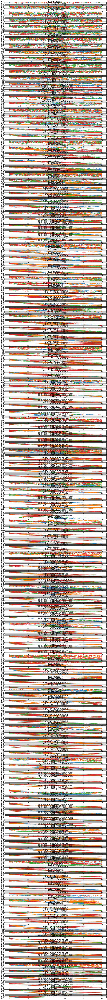

In [16]:
# GRAPH STABILISATION DES OVERLAPS
fig, axs = plt.subplots(len(list_value_1)*len(list_value_2), figsize=(20,200), facecolor='white')
fig.tight_layout()

for i in range(len(list_value_1)*len(list_value_2)):
    axs[i].grid()
    axs[i].set_ylabel("overlap")
    axs[i].set_title(f"{name_value_1}={list_value_1[i//len(list_value_2)]}"
                    + f" & {name_value_2}={list_value_2[i%len(list_value_2)]}")
    for run_in_on_sample in range(size_of_one_sample):
        axs[i].plot(overlap_at_each_iterations[i][run_in_on_sample])

<ipython-input-10-151dd5b5ce2c>:3: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.tight_layout()


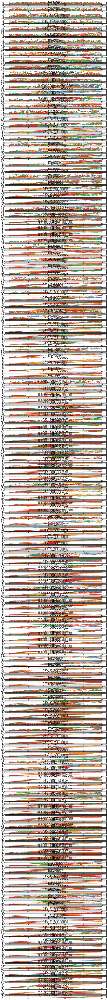

In [10]:
# GRAPH STABILISATION DES MEAN SQUARRE ERRORS
fig, axs = plt.subplots(len(list_value_1)*len(list_value_2), figsize=(20,200), facecolor='white')
fig.tight_layout()

for i in range(len(list_value_1)*len(list_value_2)):
    axs[i].grid()
    axs[i].set_ylabel("mse")
    axs[i].set_title(f"{name_value_1}={list_value_1[i//len(list_value_2)]}"
                    + f" & {name_value_2}={list_value_2[i%len(list_value_2)]}")
    for run_in_on_sample in range(size_of_one_sample):
        axs[i].plot(mse_at_each_iterations[i][run_in_on_sample])

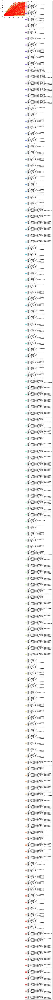

In [12]:
# PRINT THE OVERLAP IN FUNCTION OF THE STEP

# On calcul la moyenne des overlaps à chaque itérations dans un même sample avec:
# overlap_at_each_iterations.mean(axis=1)
#
# ~ moyenne_sample_1 = run_1_s1 + run_2_s2 + ... / size_of_one_sample
# ~ moyenne_sample_2 = run_1_s2 + run_2_s2 + ... / size_of_one_sample
# ...

# On calcul la moyenne des overlaps u et v à chaque itérations pour chaque sample avec:
# overlap_at_each_iterations.mean(axis=1)
#
# ~ moyenne_sample_1_uv = (moyenne_sample_1_u + moyenne_sample_1_v)/2
# ...

overlap_at_each_iterations_per_sample=overlap_at_each_iterations.mean(axis=1).mean(axis=2)

plt.figure(facecolor='white')
plt.grid()
plt.ylabel("overlap")
plt.xlabel("iterations")
color=iter(cm.rainbow(np.linspace(0,1,len(list_value_1)*len(list_value_2))))

for i in range(len(list_value_1)*len(list_value_2)):
    c=next(color)
    plt.plot(overlap_at_each_iterations_per_sample[i], 
             label=f"{name_value_1}={list_value_1[i//len(list_value_2)]}"
            + f" & {name_value_2}={list_value_2[i%len(list_value_2)]}", color=c)
plt.legend(loc='upper right', bbox_to_anchor=(2, 1))

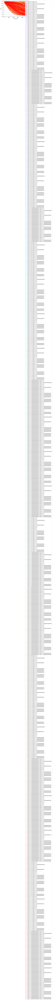

In [13]:
# PRINT THE MSE IN FUNCTION OF THE STEP
# same as the cell above but with the men squarre error:

mse_at_each_iterations_per_sample=mse_at_each_iterations.mean(axis=1).mean(axis=2)

plt.figure(facecolor='white')
plt.grid()
plt.ylabel("mse")
plt.xlabel("iterations")
color=iter(cm.rainbow(np.linspace(0,1,len(list_value_1)*len(list_value_2))))

for i in range(len(list_value_1)*len(list_value_2)):
    c=next(color)
    plt.plot(mse_at_each_iterations_per_sample[i], 
             label=f"{name_value_1}={list_value_1[i//len(list_value_2)]}"
            + f" & {name_value_2}={list_value_2[i%len(list_value_2)]}", color=c)
plt.legend(loc='upper right', bbox_to_anchor=(2, 1))

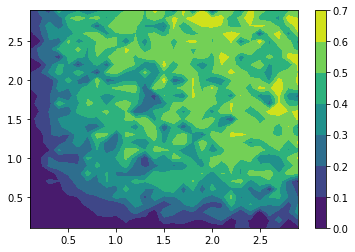

In [14]:
# CONTOUR PLOT OVERLAP
# moyenne de tous les runs dans un sample:
# overlap_at_final_iteration.mean(axis=1))
# moyenne entre u et v:
# overlap_at_final_iteration.mean(axis=1).mean(axis=1)

overlap_mean=overlap_at_final_iteration.mean(axis=1).mean(axis=1)

x, y = np.meshgrid(list_value_2,list_value_1)
overlap_mean=overlap_mean.reshape(len(list_value_1),len(list_value_2))

fig,ax=plt.subplots(1,1, facecolor='white')
c = ax.contourf(x,y,overlap_mean)
fig.colorbar(c)
plt.show()


In [15]:
# with: [0.20049438 0.41059345 0.49443045 0.3862359  0.52844316 0.56942856]

# xx= [[0.5 1.  2. ]
#      [0.5 1.  2. ]]

# yy= [[0.5 0.5 0.5]
#      [1.  1.  1. ]]

# res= [[0.20049438 0.41059345 0.49443045]
#       [0.3862359  0.52844316 0.56942856]]

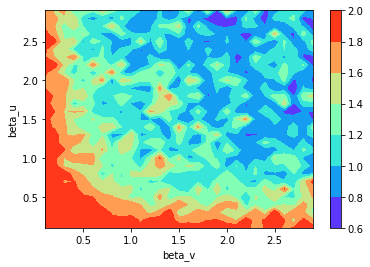

In [41]:
# CONTOUR PLOT MSE
# moyenne de tous les runs dans un sample:
# overlap_at_final_iteration.mean(axis=1))
# moyenne entre u et v:
# overlap_at_final_iteration.mean(axis=1).mean(axis=1)

mse_mean=mse_at_final_iteration.mean(axis=1).mean(axis=1)

x, y = np.meshgrid(list_value_2,list_value_1)
mse_mean=mse_mean.reshape(len(list_value_1),len(list_value_2))

fig,ax=plt.subplots(1,1, facecolor='white')
cmap=cm.get_cmap('rainbow')
c = ax.contourf(x,y,mse_mean,cmap=cmap)
fig.colorbar(c)
ax.set_xlabel(f"{name_value_2}")
ax.set_ylabel(f"{name_value_1}")
plt.show()